In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import cv2
import os
from collections import defaultdict
from scipy.stats import kurtosis, skew
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.metrics.pairwise import cosine_similarity

In [7]:
#our folder path is the following:
main_folder = r'Pandora_V1'
#all our pool images will be of size 16 x 16 x 3
img_width = 16
img_height = 16

## Image database loading and initial image processing 

In [8]:
# creating functions for our features

In [9]:
# definition of the mean
def statistics(image_size,color_scale,hist):
    #image size,color scale in this case from 0 to 255, h is the color histogram.
    
    # calculating the mean
    freq=0
    for n in color_scale:
        freq += (n*hist[n]) 
    mean = freq/image_size
    
    #getting the variance
    freq2=0
    for n in color_scale:
        freq2 += (n-mean)**2*hist[n]
    variance = freq2/image_size
    

    return mean, variance

In [12]:
images_array = []
KM_features = []
image_id =  []

for folder in os.listdir(main_folder):
    for file in os.listdir(os.path.join(main_folder, folder)):
                
        path = os.path.join(main_folder, folder, file)
        img = cv2.imread(path,1) #select all the images in the folder
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB) #transform into RGB format
        img = cv2.resize(img, (img_width,img_height), interpolation = cv2.INTER_CUBIC) #rewsize each image 
        img = np.array(img).astype('uint8') # change data type to float
        
        for i in range(0,3):
            hist = cv2.calcHist([img],[i],None,[256],[0,256])
            #getting the mean, variance and skewness
            stats = statistics(256, range(0,256), hist)
            mean=stats[0]
            variance=stats[1]
            KM_features.append(mean)
            KM_features.append(variance)
            
        
        # Now we append the image into the images_array.
        images_array.append(img)
        
        # We also want to keep track of each individual image with an id
        image_id.append(path)

In [11]:
images_array = np.array(images_array)
print(images_array.shape)

KM_features = np.array(KM_features)
KM_features = KM_features.reshape(images_array.shape[0],6) #reshaping  
print(KM_features.shape) #checking on the new shape of the array.


(0,)
(0, 6)


We now have an array with 9 features for each photo. Mean, variance and skewness for each of the color dimensions. 
We can now run the K-Mean algorithm and get 6 clusters to classify our images based on these 9 features.

## K-means clustering

In [7]:
n_clusters = 6
k_means = KMeans(n_clusters = 6)
#Fit the model to the data
K_means_model = k_means.fit(KM_features)
labels = K_means_model.labels_
centers = K_means_model.cluster_centers_
inertia_score = K_means_model.inertia_

print(labels)
print(centers)
print(inertia_score)

[2 1 1 ... 1 1 0]
[[ 128.32774  3435.3528    115.37786  3566.7522    102.61664  3938.5825  ]
 [ 111.51147  3300.2644     87.53604  2502.3508     67.166275 1751.3209  ]
 [ 114.56546  5199.8047     90.18917  3810.5127     68.88272  2497.371   ]
 [ 130.59712  8380.023     123.17131  8350.028     117.53392  8127.893   ]
 [ 125.57822  5577.4434    113.504845 5440.6606    101.96152  5340.758   ]
 [  92.56332  1914.1664     73.303474 1379.3552     57.87133  1025.9346  ]]
12631980032.0


We have a very big inertia score. Let us see what is the ideal K using the inertia score.

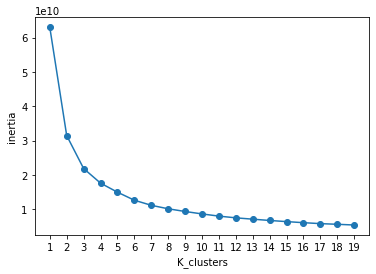

In [8]:
ks = range(1,20)
inertia_list = []
for k in ks:
    
    # Fit our model
    k_means_optimized = KMeans(n_clusters=k)
    k_means_optimized.fit(KM_features)
    
    # Get out the inertia score
    inertia_list.append(k_means_optimized.inertia_)
    
# let us have a visual of the optimization
plt.figure()
plt.plot(ks, inertia_list, marker="o")
plt.xlabel('K_clusters')
plt.ylabel('inertia')
plt.xticks(ks)
plt.show()


Based on the inertia plot a reasonable K value is 6. Witch happens to be the one we chose. 
We are also interested in knowing for each K how similar are the paintings within their own cluster. For this we can use the silhouette score. 

In [9]:
silhouette_scores = []

for k in range(2, 10):
    k_means_optimized = KMeans(n_clusters=k)
    k_means_optimized.fit(KM_features)
    
    my_silhouette_score = silhouette_score(KM_features, k_means_optimized.predict(KM_features))
    silhouette_scores.append(my_silhouette_score)

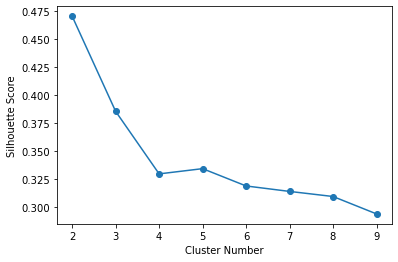

In [10]:
plt.figure()
plt.plot(range(2,10), silhouette_scores, marker="o")
plt.xlabel("Cluster Number")
plt.ylabel("Silhouette Score")
plt.show()

We have a terrible silhouette curve that has a decreasing slope. As the number of clusters increases the silhouette score decreases. We will stick to the inertia curve for now and dig more into our results.

Let us see the distribution of our 6 classes

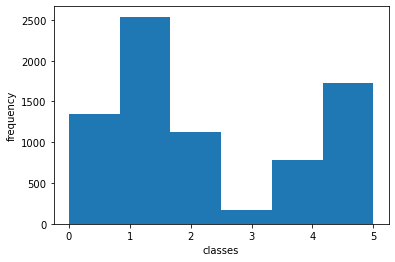

In [11]:
plt.figure()
plt.hist(labels, bins=6)
plt.ylabel('frequency')
plt.xlabel('classes')
plt.show()

It is clear that our classes are not evenly distributed and this could cause problems later on when trying to find the best image fit for the input image and the different blocks. We can visually check our different classes.

In [12]:
labels.shape

(7694,)

In [13]:
labels = list(labels) # converting labels into a list
dic = {'Path':image_id, 'class':labels}
df = pd.DataFrame(dic)

In [14]:
class_0 = df[df['class']==0] 
class_1 = df[df['class']==1]
class_2 = df[df['class']==2]
class_3 = df[df['class']==3]
class_4 = df[df['class']==4]
class_5 = df[df['class']==5]
             
class_0.reset_index(inplace=True, drop=True)
class_1.reset_index(inplace=True, drop=True)
class_2.reset_index(inplace=True, drop=True)
class_3.reset_index(inplace=True, drop=True)
class_4.reset_index(inplace=True, drop=True)
class_5.reset_index(inplace=True, drop=True)

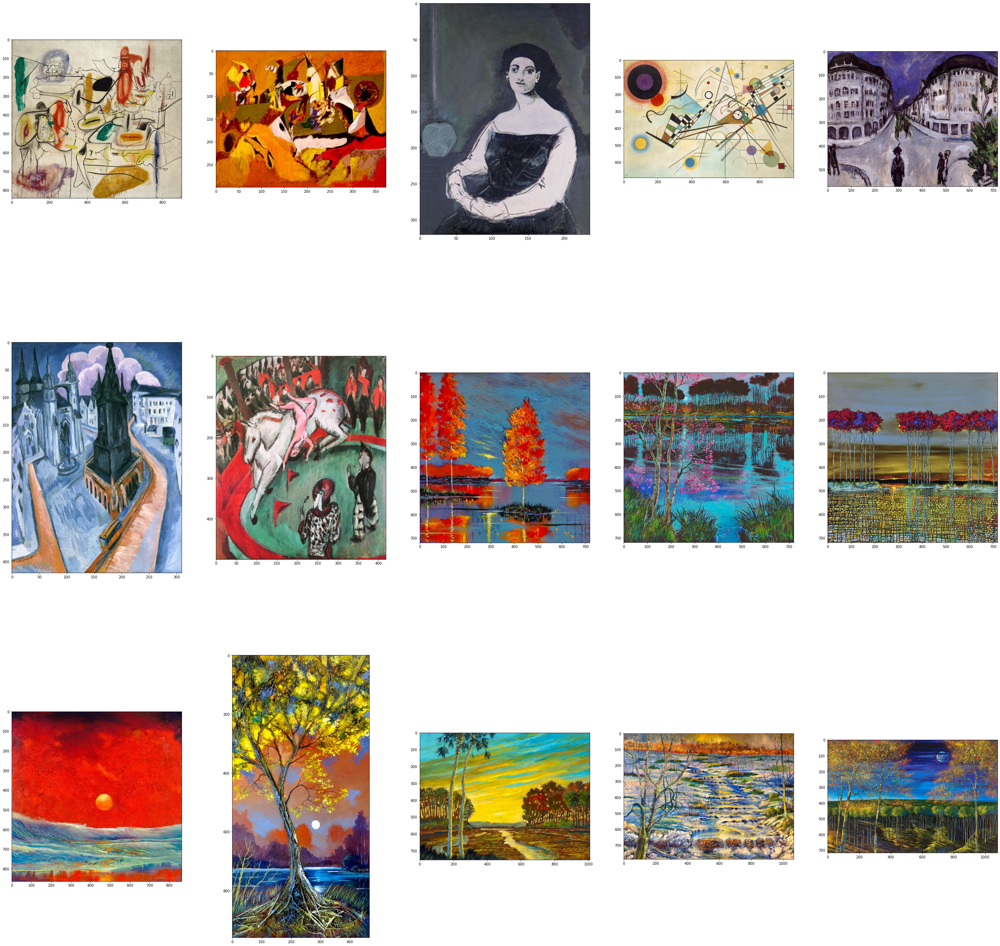

In [15]:
#we will plot each tile separetly as a subplot using the array with all the tiles in it. 
fig=plt.figure(figsize = (50,50))

for i in range(0,15):
    img = cv2.imread(class_0.iloc[i,0],1)
    b,g,r = cv2.split(img)
    img=cv2.merge([r,g,b])
    fig.add_subplot(3,5,i+1)
    plt.imshow(img)
plt.show()

We see can see some similarities between our samples however the inertia and silhouette scores are very low. We will incorporate the flattened image into the array so that we have the extracted features and the whole image to run our model from.

### Let us incorporate the flattened image into the analysis and fit a K-mean algorithm. 

In [16]:
#We will get a new array with the image features and the flattened image concatenated at the end to see if we get better results.  
# we will append everything into the images_array

images_array = []
image_id =  []

for folder in os.listdir(main_folder):
    for file in os.listdir(os.path.join(main_folder, folder)):
                
        path = os.path.join(main_folder, folder, file)
        img = cv2.imread(path,1) #select all the images in the folder
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB) #transform into RGB format
        img = cv2.resize(img, (img_width,img_height), interpolation = cv2.INTER_CUBIC) #rewsize each image 
        img = np.array(img).astype('uint8') # change data type to float
        
        for i in range(0,3):
            hist = cv2.calcHist([img],[i],None,[256],[0,256])
            #getting the mean, variance and skewness
            stats = statistics(256, range(0,256), hist)
            mean=stats[0]
            variance=stats[1]
            images_array.append(mean)
            images_array.append(variance)
        
        # Now we append the image into the images_array.
        flat_img = img.reshape(768)
        for i in range(0,flat_img.shape[0]):
            images_array.append(flat_img[i])
        
        # We also want to keep track of each individual image with an id
        image_id.append(path)

In [17]:
images_array = np.array(images_array)
print(f'the images_array has a shape of: {images_array.shape}')
#we reshape the array as follows to have one array per image. 
images_array = images_array.reshape(7694,774)
print(f'the new shape is {images_array.shape}')

the images_array has a shape of: (5955156,)
the new shape is (7694, 774)


In [18]:
n_clusters = 6

k_means = KMeans(n_clusters = n_clusters)
#Fit the model to the data
K_means_model = k_means.fit(images_array)
labels = K_means_model.labels_
centers = K_means_model.cluster_centers_
inertia_score = K_means_model.inertia_

print(labels)
print(centers)
print(inertia_score)

[5 1 1 ... 1 3 5]
[[ 124.12929547 5803.19689282  110.54643889 ...   89.85714286
    75.35294118   63.95558223]
 [ 142.43214328 2546.82676356  117.90317294 ...  129.49342517
   103.78334377   78.53663118]
 [ 105.5026021  4450.95387463   80.94063411 ...   86.70641229
    64.69369369   48.35135135]
 [  74.62404006 2300.06399689   56.50908826 ...   60.72606383
    46.11808511   37.13404255]
 [ 130.85436276 8383.93067289  123.4040145  ...   85.40963855
    79.05421687   76.13253012]
 [ 130.52525709 3729.19651757  117.24140977 ...  103.36964688
    87.87678437   72.17355372]]
36239686767.640976


Our inertia score still very big. Our results did not seem to improve. Let us see what is the optimal k-value to have

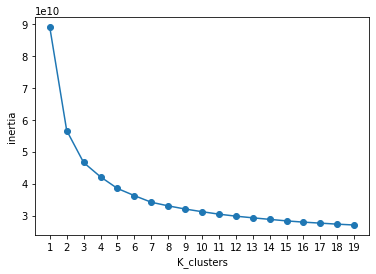

In [19]:
ks = range(1,20)
inertia_list = []
for k in ks:
    
    # Fit our model
    k_means_optimized = KMeans(n_clusters=k)
    k_means_optimized.fit(images_array)
    
    # Get out the inertia score
    inertia_list.append(k_means_optimized.inertia_)
    
# let us have a visual of the optimization
plt.figure()
plt.plot(ks, inertia_list, marker="o")
plt.xlabel('K_clusters')
plt.ylabel('inertia')
plt.xticks(ks)
plt.show()

Our K-values still very high ans is similar to the one that we had before. Let us calculate the silhouette score and see if we get better results. The ideal K-value seems to be between 4 and 6 classes.

In [20]:
silhouette_scores = []

for k in range(2, 10):
    k_means_optimized = KMeans(n_clusters=k)
    k_means_optimized.fit(images_array)
    
    my_silhouette_score = silhouette_score(images_array, k_means_optimized.predict(images_array))
    silhouette_scores.append(my_silhouette_score)

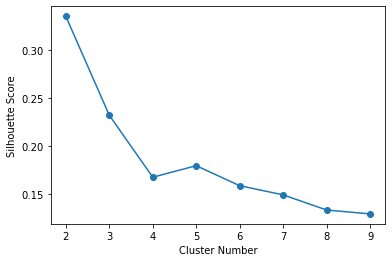

In [21]:
plt.figure()
plt.plot(range(2,10), silhouette_scores, marker="o")
plt.xlabel("Cluster Number")
plt.ylabel("Silhouette Score")
plt.show()

based on the K optimization and silhouette graph it looks like the best option would be to have 5 different clusters. We will refit our model with 5 clusters and check the distribution of our classes. 

In [22]:
n_clusters = 5
k_means = KMeans(n_clusters = n_clusters)
#Fit the model to the data
K_means_model = k_means.fit(images_array)
labels = K_means_model.labels_
centers = K_means_model.cluster_centers_
inertia_score = K_means_model.inertia_

print(labels)
print(centers)

[2 4 4 ... 0 0 2]
[[  83.70153369 2319.83538838   63.8340722  ...   70.28372302
    53.47302158   41.65692446]
 [ 107.00880481 4324.64075822   81.99085743 ...   88.25256473
    65.93063019   49.50952614]
 [ 124.98936489 4790.08680457  110.80470814 ...   94.48745046
    78.77344782   64.84081902]
 [ 129.68572751 7449.23528382  120.07905076 ...   83.37861272
    73.68786127   67.84682081]
 [ 144.84132328 2647.61888619  125.89510857 ...  129.44849648
   107.95521433   84.97440819]]


Let us see the distribution of our 5 classes to see if we have a distribution that is more even than the one we got before.

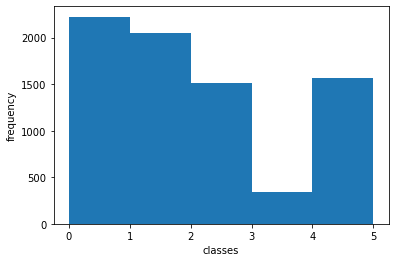

In [23]:
plt.figure()
plt.hist(labels, bins=[0,1,2,3,4,5])
plt.ylabel('frequency')
plt.xlabel('classes')
plt.show()

This distribution looks more even than the one we got before. By having a more even distribution, once we have classified the tiles and we are looking for the best image match having an even distribution will save on computing time since we will go over a similar amount of images per class.
Let us see a sample of the images in one of the clusters to have a visual idea on how our model did.  

In [24]:
labels = list(labels) # converting labels into a list
dic = {'Path':image_id, 'class':labels}
df = pd.DataFrame(dic)

In [25]:
class_0 = df[df['class']==0] 
class_1 = df[df['class']==1]
class_2 = df[df['class']==2]
class_3 = df[df['class']==3]
class_4 = df[df['class']==4]
class_5 = df[df['class']==5]
             
class_0.reset_index(inplace=True, drop=True)
class_1.reset_index(inplace=True, drop=True)
class_2.reset_index(inplace=True, drop=True)
class_3.reset_index(inplace=True, drop=True)
class_4.reset_index(inplace=True, drop=True)
class_5.reset_index(inplace=True, drop=True)

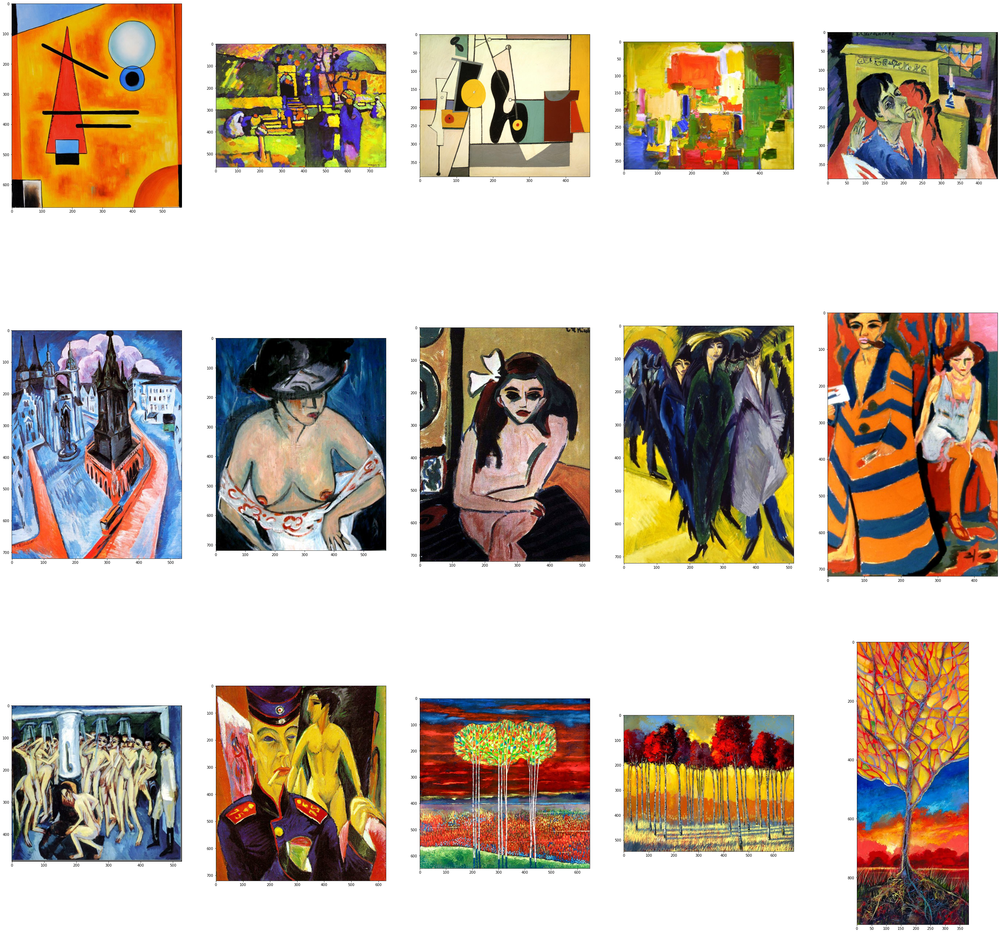

In [29]:
#we will plot each tile separetly as a subplot using the array with all the tiles in it. 
fig=plt.figure(figsize = (50,50))

for i in range(0,15):
    img=cv2.imread(class_2.iloc[i,0],1)
    b,g,r = cv2.split(img)
    img=cv2.merge([r,g,b])
    fig.add_subplot(3,5,i+1)
    plt.imshow(img)
plt.show()

From the sample above we see a lot of blue and a lot of red. However this doesn't tell us much. 

By including the flattened image into our array we did not see any improvements on the silhouette or inertia score. However, by fitting our model to K = 5 we had a better distribution of our classes. This will allow us to save some computing time in the future.

Our end goal is not to choose the closest image possible to a tile. By classifying our images and tiles before looking for the best match is only allowing us to save computing time. Thus, our evaluation scores are not a key component to achieve our final product. 
By having our database classified in evenly distributed clusters we can expect the computation to be performed faster.
We can continue to build the final mosaic, see the final product and come back to the fitted model in case we don't get the desired output.

Our next steps are:
- Process the input image by slicing the image in the width and height of our database images.
- Get an array with the mean and variance of each channel and the flattened tile.
- Classify each tile with the model that we have
- Match each tile with one of the images of the same class
- Build the final image.

# Input image processing

In [30]:
input_image = 'Input_images/baboon.jpg'
input_img_width = 640
input_img_height = 640

Reading the Input_image from the folder

In [31]:
input_img = cv2.imread(input_image)
input_img = cv2.resize(input_img, (input_img_width,input_img_height), interpolation = cv2.INTER_CUBIC)
input_img = cv2.cvtColor(input_img, cv2.COLOR_BGR2RGB) #transform into RGB format
input_img = np.array(input_img).astype('uint8')
input_img.shape

(640, 640, 3)

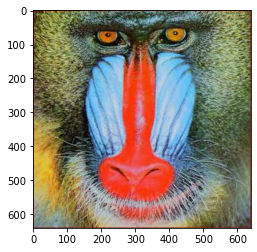

In [32]:
plt.imshow(input_img)
plt.show()

Now that we have the image loaded and in the right size we want to cut it into tiles. We want the tiles to be the same size than the pictures from our Database. img_height, img_width, number of channels. (16X16X3)

To achieve this we select the height of the tiles and we loop over the width of the input image with steps the width of the tile. All of this while storing each tile into a list.
we have to repeat this process for the whole height of the input image and for every channel. 

with this process tile[0] (our first tile) will be the tile in the upper-left most corner.

In [33]:
tiles = []
for x in range(0, input_img_height,img_height): #we loop over the height of our tiles
    for y in range(0, input_img_width, img_width): # we loop over the width of our tiles
    
            tile = input_img[x:x+img_height,y:y+img_width,0:3] # we run the loop and cut within the 3 channels
            #we append each tile into the created list
            tiles.append(tile)

# our tile[0] is the tile in the upper-left side of our image

In [34]:
type(tiles[0])

numpy.ndarray

In [35]:
# let us check the shape of our tiles
tiles[0].shape

(16, 16, 3)

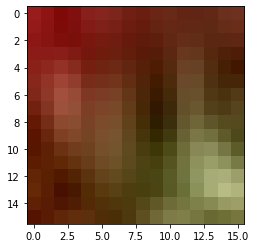

In [36]:
#let us have a visual of the tile
plt.imshow(tiles[0])
plt.show()

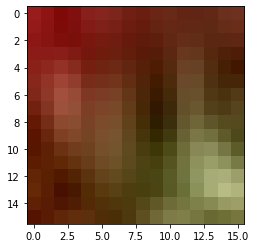

In [37]:
#we can compare the visual with the direct crop of the image. 
plt.imshow(input_img[0:16,0:16,0:3])
plt.show()

Both tiles seem to be the same. However, let us compare them numerically to make sure they are identical. 
We start by getting a boolean array for each pixel and we compute the sum to see if it is equal to the total size of the image.

In [38]:
#get the boolean array
check = tiles[0] == input_img[0:16, 0:16, 0:3]
# compute the sum: we are expecting as a result 16*16*3 = 768
check.sum()

768

Both tiles are equal!!! we can now predict to witch cluster each tile belongs to. 

# Predicting the cluster each tile belongs to using K-Means

We have a list with all of our tiles. We can loop over them and predict the cluster they belong to.
We start by processing the tile the same way we processed the input images.

In [39]:
# let us check the lenght of the tiles list
len(tiles)

1600

In [40]:
# we will loop over the 1600 tiles and create the equivalent vector that we had for each of the images from the dataset. 

In [41]:
tiles_array = []

for t in range(0,len(tiles)):
    for i in range(0,3):
        hist = cv2.calcHist(tiles[t],[i],None,[256],[0,256])
        #getting the mean, variance and skewness
        stats = statistics(256, range(0,256), hist)
        mean=stats[0]
        variance=stats[1]
        tiles_array.append(mean)
        tiles_array.append(variance)
        #images_array.append(skew)
        
    # Now we flatten the tile and append it into the tiles_array. we do this by appending one pixel at a time. 
    flat_tile = tiles[t].reshape(768)
    for i in range(0,flat_tile.shape[0]):
        tiles_array.append(flat_tile[i])

In [42]:
#we check the lenght of the list that holds the new processed arrays. 
# we are looking for a list with lenght: 1,238,400 that we can reshape in the following way:
#1600 arrays and each array be of shape (1,774)
print(f'the tiles_array lenght is: {len(tiles_array)}')

#reshaping
tiles_array = np.array(tiles_array).reshape(1600,774)
print(f'tiles_arrray shape: {tiles_array.shape}')

the tiles_array lenght is: 1238400
tiles_arrray shape: (1600, 774)


In [43]:
# we select the first tile and check the shape of it
tiles_array[0].shape

(774,)

we need to reshape each tile to match the images array and be able to predict the cluster that the images belong to.

In [44]:
# we reshape and loop over the whole tiles_array. 
tiles_class=[K_means_model.predict(tiles_array[i].reshape(1,-1)) for i in range(0,tiles_array.shape[0])]


In [45]:
#we check the results. we are expecting a lenght of 1600 a class clasification for each tile. 
print(f'lenght of tiles_class: {len(tiles_class)}')
print(f'type of tiles_class: {type(tiles_class)}')

lenght of tiles_class: 1600
type of tiles_class: <class 'list'>


In [46]:
# we need to change the list to an array of shape (-1,1) to concatenate this array latter on. 
tiles_class = np.array(tiles_class).reshape(-1,1)

We now have the classified images and the predicted classification with each tile. We can access the images classification with the labels method.
To recap we have:
 - images_array: the array holding features and the flattened images
 - tiles_array: the array holding features and the flattened tiles
 - tiles_class: the array holding the class that each tile belongs too from the fitted K-means model. 

next steps:
 - get an array with the labels of each image to know to witch class they belong to. 
 - concatenate the images_array and the newly crated labels array to be able to match each image and tile of the same class.
 - filter the concatenated array by class
 - concatenate the tiles_array and tiles_class array to be able to match each image and tile of the same class. 
 - run cosine similarity for each tile with the images that belong to the same class. 

In [47]:
# we verify again the shape of the images array.
images_array.shape

(7694, 774)

In [48]:
# we get the array with the labels of each image as above. 
labels = np.array(labels)

In [49]:
# we check the shape of the array to concatenate with the images_array
labels.shape

(7694,)

we need to reshape the labels array to match the images array and find a match. we need the labels array to have the same number of rows than the images array but only one column. This means the array needs to be of shape (7694,1)

In [50]:
# we reshape the array to make a match.
labels = np.array(labels).reshape(images_array.shape[0],1)

In [51]:
#we check the new shape.
labels.shape

(7694, 1)

In [52]:
# Now that we have both arrays with the right shape we can concatenate them. 
class_image_array = np.concatenate((images_array, labels), axis=1)

In [53]:
# In order to filter the new array and get an array for each class with the respective image we transform it into a DataFrame. 
df_class_image = pd.DataFrame(class_image_array )

In [54]:
# we create one array for each class. In this case from class 0 to 4.
# we select all the columns for each new array so that we have all the information needed to do the match later on and
#re build the image. We have to remove the last column that we just created. The best way to do this will be a dictionarry. 
class_dic = {}
for i in range(0,n_clusters):
    class_dic["class_{0}_array".format(i)] = np.array(df_class_image[df_class_image.iloc[:,-1] == i])[:,:-1]

In [55]:
# we check the dict.
class_dic

{'class_0_array': array([[array([189.03125], dtype=float32),
         array([2046.0527], dtype=float32),
         array([151.0039], dtype=float32), ..., 218, 158, 85],
        [array([62.6875], dtype=float32),
         array([3285.1372], dtype=float32),
         array([71.74609], dtype=float32), ..., 21, 15, 34],
        [array([94.82422], dtype=float32),
         array([886.3324], dtype=float32),
         array([89.015625], dtype=float32), ..., 99, 89, 72],
        ...,
        [array([145.53906], dtype=float32),
         array([2715.3584], dtype=float32),
         array([124.07422], dtype=float32), ..., 41, 42, 44],
        [array([118.53516], dtype=float32),
         array([2659.5684], dtype=float32),
         array([96.93359], dtype=float32), ..., 119, 101, 87],
        [array([106.421875], dtype=float32),
         array([2537.3933], dtype=float32),
         array([47.277344], dtype=float32), ..., 29, 3, 0]], dtype=object),
 'class_1_array': array([[array([110.375], dtype=float32),

We have now a dictionary with 4 array, one per class with all the pictures classified.
We need to check now the shape of each array and each image.

In [56]:
# we check each array and see the number of images and size. 
check_list = [class_dic['class_{0}_array'.format(i)].shape for i in range(0, n_clusters)]
check_list

[(2224, 774), (2047, 774), (1514, 774), (346, 774), (1563, 774)]

This numbers are the same than the ones from the labels histogram from before. 
and each image is flatten and of size 774. 
We now need to concatenate the tiles_array and the tiles_class to see the distribution of our predictions

In [57]:
#concatenating both arrays
print(f'shape of tiles_array: {tiles_array.shape} shape of tiles_class: {tiles_class.shape}')

shape of tiles_array: (1600, 774) shape of tiles_class: (1600, 1)


In [58]:
tiles_array_class = np.concatenate((tiles_array, tiles_class), axis=1)

In [59]:
tiles_array_class.shape

(1600, 775)

Now that we concatenated both arrays we have the flattened tile with the predicted label attached to it.  

In [60]:
df_tiles_class = pd.DataFrame(tiles_array_class)
tiles_dic = {}
for i in range(0,n_clusters):
    tiles_dic["tiles_{0}_class".format(i)] = np.array(df_tiles_class[df_tiles_class.iloc[:,-1] == i])[:,:-1]

In [61]:
check_tiles = [tiles_dic['tiles_{0}_class'.format(i)].shape for i in range(0, n_clusters)]
check_tiles

[(668, 774), (0, 774), (216, 774), (0, 774), (716, 774)]

We can see that for the predicted tiles we only have three classes that were predicted witch indicates that the tiles that we are classifying are very similar to each other. We can foresee that some tiles will be matched to the same image since they are very similar to each other. This might affect the final result that we are looking for. Let us continue with these results and build the final mosaic before doing any changes.

Our next step is to compute the cosine similarity between a tile of a given class and all the images of the same class to get a match of the closest image.

In [62]:
# checking the shape of the tile
tile.shape

(16, 16, 3)

In [63]:
# checking the shape of the images
class_dic["class_{0}_array".format(0)][1,:]

array([array([62.6875], dtype=float32), array([3285.1372], dtype=float32),
       array([71.74609], dtype=float32),
       array([2196.6506], dtype=float32),
       array([85.03516], dtype=float32),
       array([1614.8232], dtype=float32), 17, 20, 29, 38, 36, 62, 22, 23,
       36, 45, 40, 65, 31, 31, 47, 36, 34, 46, 25, 25, 34, 25, 25, 54, 34,
       41, 50, 46, 46, 67, 41, 41, 57, 31, 35, 58, 28, 35, 64, 24, 39, 73,
       39, 50, 83, 34, 38, 65, 25, 32, 36, 13, 16, 22, 41, 43, 58, 25, 28,
       62, 62, 106, 128, 31, 35, 62, 30, 36, 58, 17, 23, 50, 22, 43, 80,
       16, 31, 73, 55, 69, 113, 37, 45, 79, 46, 67, 107, 126, 142, 126,
       15, 40, 74, 29, 44, 65, 29, 33, 50, 23, 29, 46, 26, 30, 51, 30, 34,
       69, 34, 77, 113, 85, 62, 99, 29, 35, 70, 55, 92, 116, 29, 57, 97,
       30, 60, 110, 144, 145, 140, 158, 159, 152, 66, 71, 78, 26, 38, 75,
       18, 40, 74, 34, 47, 63, 12, 18, 42, 21, 26, 52, 12, 48, 72, 161,
       158, 1, 16, 45, 92, 33, 46, 97, 201, 188, 166, 17, 32, 8

In [64]:
%%time
# we will compute how long the matching takes to run to compare it will the the code that does not have a classification.

match_dic={}

for i in range(0, tiles_class.shape[0]):
    # selecting the class of the first tile. 
    c = int(tiles_class[i,:])
    tile = tiles_array[i,:].reshape(1,774)
    
    # seting up the maximum back to 0
    maximum = 0
    
    #loop through each image of the given class array
    for j in range(0,class_dic["class_{0}_array".format(c)].shape[0]):
        cluster_image = class_dic["class_{0}_array".format(c)][j,:].reshape(1,774)
    
        #calculating the cosine similarity with to find the best match
        cosine_similarities = cosine_similarity(tile, cluster_image)

        # once we have the cosine similarity calculated we need to find the maximum value 
        if cosine_similarities > maximum:
            maximum = cosine_similarities
            match_dic['tile{0}'.format(i)]= cluster_image
                
        else:
            continue

Wall time: 12min 36s


we now have the dictionary that will allow us to build our photo mosaic. We will check the length of the new dictionary to make sure it is what we are looking for. 

In [65]:
#we are looking for a length of 1600 one image per tile
len(match_dic)

1600

let us just check visually how similar tile 1 and the matched image are. to do this we need to extract the original arrays without the extracted features.

In [66]:
# extracting tile 1, reshaping and removing the first 6 calculated features.
tile_1 = tiles_array[0,6:].reshape(16,16,3).astype('uint8')

#extracting the matched image, reshaping and removing the first 6 calculated features.
image_1 = match_dic['tile1'][:,6:].reshape(16,16,3).astype('uint8')


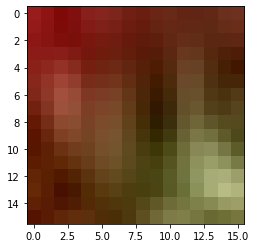

In [67]:
#we can compare the visual with the direct crop of the image. 
plt.imshow(tile_1)
plt.show()

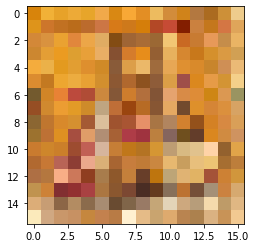

In [68]:
#we can compare the visual with the direct crop of the image. 
plt.imshow(image_1)
plt.show()

The visual is very different from the but we need to plot the whole picture and compare our results to have an idea on how good our algorithm did.

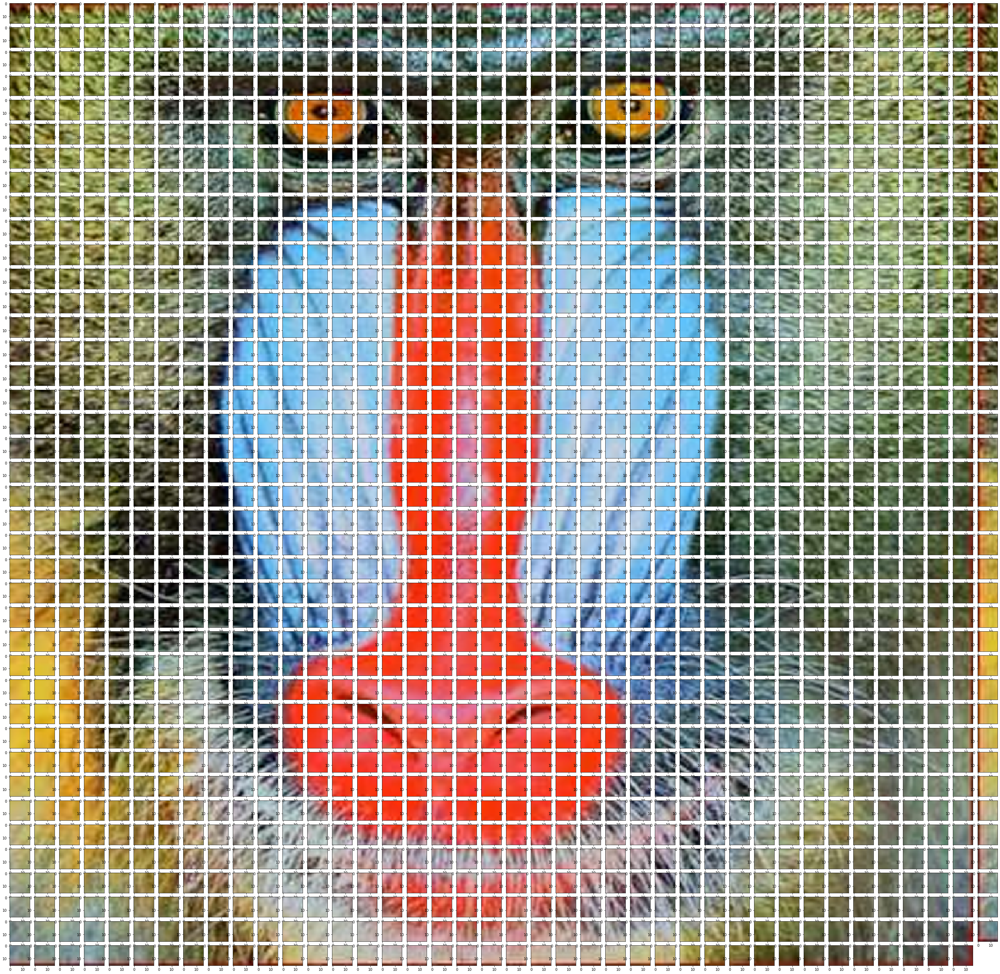

In [69]:
#we will plot each tile separetly as a subplot using the array with all the tiles in it. 

fig=plt.figure(figsize = (50,50))

for i in range(1,1600):
    img = tiles_array[i,6:].reshape(16,16,3).astype('uint8')
    fig.add_subplot(40,40,i)
    plt.imshow(img)
plt.show()

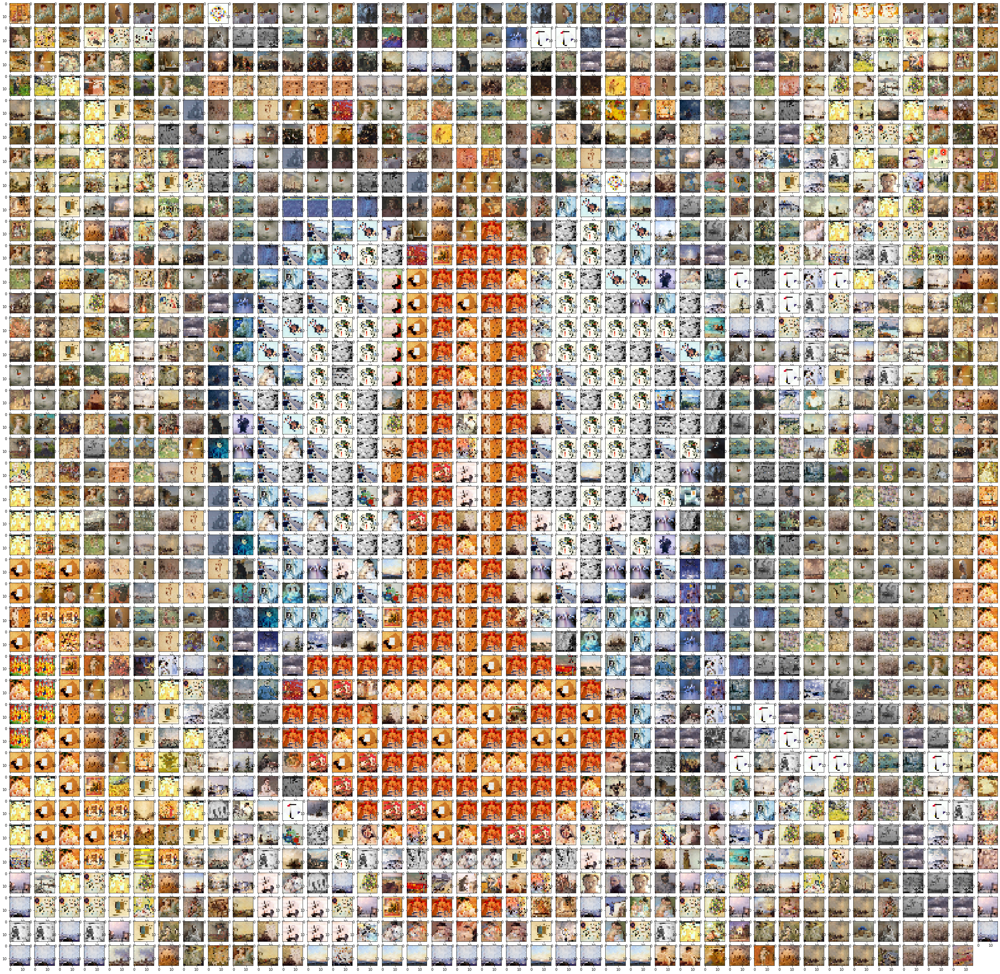

In [70]:
#using the dictionary that we created before we plot each painting as a tile and subplot to see the final result

fig=plt.figure(figsize = (50,50))

for i in range(1,1600):
    img = match_dic['tile{0}'.format(i)][:,6:].reshape(16,16,3).astype('uint8')
    fig.add_subplot(40,40,i)
    plt.imshow(img)
plt.show()

We can see the general shape of the baboon and we can see that many images are repeated. The images are not clear enough to recognize the painting. However, we have a model that works.